# Multi-reflection BCDI: reconstruction notebook
## Compact SiC crystal


In [ ]:
import sys

sys.path.insert( 0, '../src' )

In [1]:
import numpy as np
import h5py as h5

from logzero import logger
import matplotlib.pyplot as plt
import TilePlot as tp
from torch.fft import fftshift as fftshift_t, fftn as fftn_t
from numpy.fft import fftshift as fftshift_o, fftn as fftn_o

import MultiReflectionSolver as mrbcdi

In [2]:
# %matplotlib notebook
%matplotlib inline

In [3]:
datafile = '../data/SiC_400nm.h5' 
resultfile = '../reconstructions/Results_SiC.h5' 

In [4]:
# defining the optimization sequence (this anticipates what is in the HDF5 data file)
# optim_plan = { 
#     'minibatches': [ 1 ], 
#     'minibatch_size': [ 4 ],
#     'iterations_per_minibatch': [ 2500 ]
# }
optim_plan = { 
    'minibatches': [ 800, 640, 480, 320, 160, 80, 40, 1 ], 
    'minibatch_size': [ 4, 4, 4, 5, 5, 5, 5, 6 ],
    'iterations_per_minibatch': [ 6, 12, 25, 50, 100, 200, 400, 2000 ]
}
new_plan = { 
    'minibatches': [ 1 ], 
    'minibatch_size': [ 6 ],
    'iterations_per_minibatch': [ 1000 ]
}

In [5]:
# data.close()

In [6]:
# with h5.File( datafile, 'r' ) as data:
data = h5.File( datafile, 'r' )
logger.info( 'Printing data tree...' )
data.visit( print )

[I 220513 09:17:58 <ipython-input-6-1f9670cba41f>:3] Printing data tree...


global
scans
scans/dataset_0
scans/dataset_0/signal
scans/dataset_1
scans/dataset_1/signal
scans/dataset_2
scans/dataset_2/signal
scans/dataset_3
scans/dataset_3/signal
scans/dataset_4
scans/dataset_4/signal
scans/dataset_5
scans/dataset_5/signal


In [7]:
data[ 'scans' ].attrs[ 'successful_scans' ]

array([0, 1, 2, 3, 4, 5])

In [8]:
logger.info( 'Loading grain data into solver. ' )
solver = mrbcdi.MultiReflectionSolver( 
    database=data, 
    signal_label='signal', 
    sigma=4.93, 
    learning_rate=2.5e-3,
    activation_parameter=1.,
#     init_amplitude_state=state.ravel(),
    minibatch_plan=optim_plan, 
    lambda_tv=1.e-5
)
logger.info( 'Created solver. ' )
logger.info( 'Successful scans: %s'%str( data[ 'scans' ].attrs[ 'successful_scans' ] ) )
    
logger.info( 'Global parameters: ' )
for key, value in solver.globals.items():
    logger.info( '\t%s: %s'%( key, value ) )

[I 220513 09:17:58 <ipython-input-8-3bf9e494d1e6>:1] Loading grain data into solver. 
[I 220513 09:18:03 <ipython-input-8-3bf9e494d1e6>:12] Created solver. 
[I 220513 09:18:03 <ipython-input-8-3bf9e494d1e6>:13] Successful scans: [0 1 2 3 4 5]
[I 220513 09:18:03 <ipython-input-8-3bf9e494d1e6>:15] Global parameters: 
[I 220513 09:18:03 <ipython-input-8-3bf9e494d1e6>:17] 	Rcryst: [[-0.0800969   0.02519393  0.99646864]
     [ 0.58986168  0.8070525   0.02700865]
     [-0.80352205  0.58994198 -0.07950334]]
[I 220513 09:18:03 <ipython-input-8-3bf9e494d1e6>:17] 	arm: 1.0
[I 220513 09:18:03 <ipython-input-8-3bf9e494d1e6>:17] 	lam: 1.3551666677582277e-10
[I 220513 09:18:03 <ipython-input-8-3bf9e494d1e6>:17] 	lattice_parms: [  3.08    3.08   10.083  90.     90.    120.   ]
[I 220513 09:18:03 <ipython-input-8-3bf9e494d1e6>:17] 	pix: 5.5e-05
[I 220513 09:18:03 <ipython-input-8-3bf9e494d1e6>:17] 	step_cubic: 20.0


In [9]:
logger.info( 'Running optimizer...' )
solver.run()

[I 220513 09:18:03 <ipython-input-9-91b907a542b2>:1] Running optimizer...


Epoch          :   0%|          | 0/8 [00:00<?, ?it/s]

Batch/minibatch:   0%|          | 0/800 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/6 [00:00<?, ?it/s]

Batch/minibatch:   0%|          | 0/640 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/12 [00:00<?, ?it/s]

Batch/minibatch:   0%|          | 0/480 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/25 [00:00<?, ?it/s]

Batch/minibatch:   0%|          | 0/320 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/50 [00:00<?, ?it/s]

Batch/minibatch:   0%|          | 0/160 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/100 [00:00<?, ?it/s]

Batch/minibatch:   0%|          | 0/80 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/200 [00:00<?, ?it/s]

Batch/minibatch:   0%|          | 0/40 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/400 [00:00<?, ?it/s]

Batch/minibatch:   0%|          | 0/1 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/2000 [00:00<?, ?it/s]

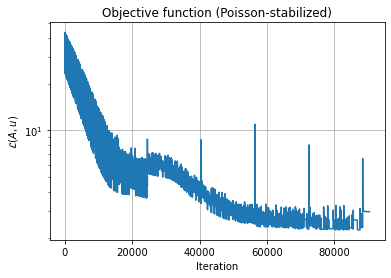

In [10]:
fig = plt.figure()
plt.semilogy( solver.error )
plt.xlabel( 'Iteration' )
plt.ylabel( '$\mathcal{L}(A, u)$')
plt.grid()
plt.title( 'Objective function (Poisson-stabilized)')
fig.canvas.draw()

In [11]:
solver.centerObject()
solver.setUpRestrictedOptimization( new_plan=new_plan, amp_threshold=0.25, learning_rate=1.e-3 )
logger.info( 'Running optimizer...' )
solver.run()

[I 220513 18:09:11 <ipython-input-11-aa61ed0b1411>:3] Running optimizer...


Epoch          :   0%|          | 0/1 [00:00<?, ?it/s]

Batch/minibatch:   0%|          | 0/1 [00:00<?, ?it/s]

Iteration      :   0%|          | 0/1000 [00:00<?, ?it/s]

In [12]:
# amp = solver.__amp__.reshape( 46, 46, 46 ).detach().cpu()
amp = solver.__amp__.reshape( 
    *( solver.cubeSize for n in range( 3 ) ) 
).detach().cpu()
u_recon = solver.__u__.detach().cpu()

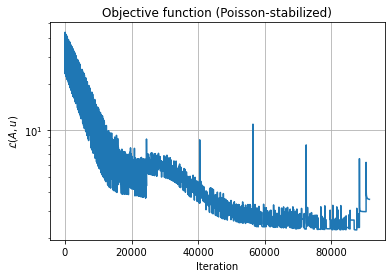

In [13]:
fig = plt.figure()
plt.semilogy( solver.error )
plt.xlabel( 'Iteration' )
plt.ylabel( '$\mathcal{L}(A, u)$')
plt.grid()
plt.title( 'Objective function (Poisson-stabilized)')
fig.canvas.draw()

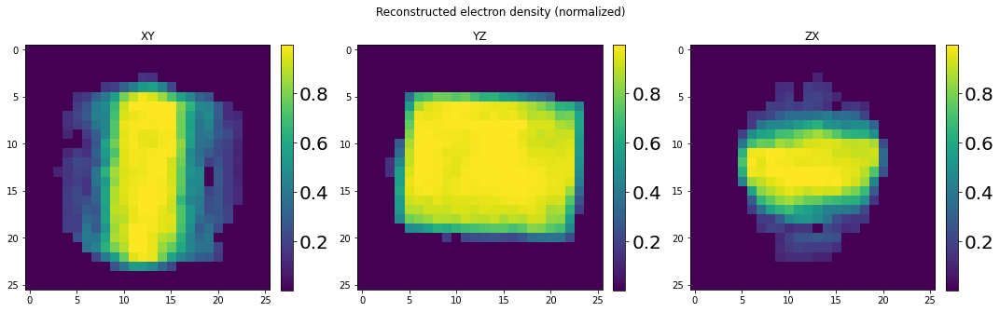

In [14]:
fig, im, ax = tp.TilePlot( 
    tuple( np.transpose( amp, np.roll( [ 0, 1, 2 ], n ) )[:,:,solver.cubeSize//2] for n in range( 3 ) ), 
    ( 1, 3 ), 
    ( 15, 5 )
)
fig.suptitle( 'Reconstructed electron density (normalized)' )
for n, st in enumerate( [ 'XY', 'YZ', 'ZX' ] ):
    ax[n].set_title( st )
    
fig.canvas.draw()

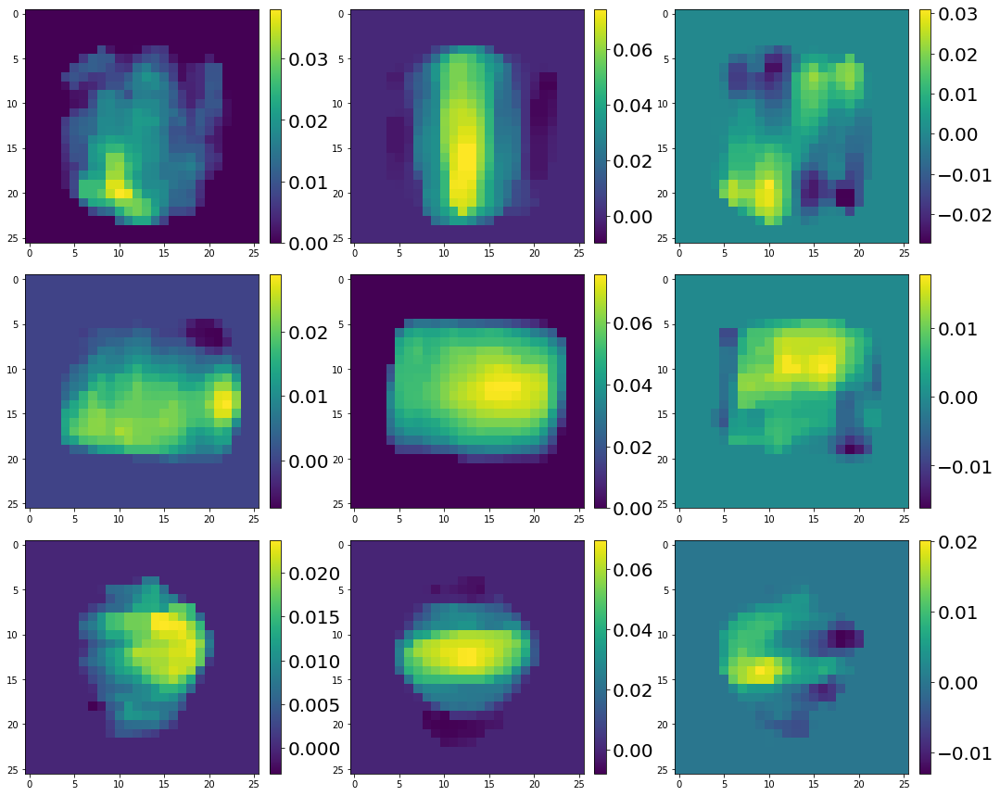

In [15]:
fig, im, ax = tp.TilePlot( 
    tuple( 
        np.transpose( arr.reshape( *( solver.cubeSize for m in range( 3 ) ) ), np.roll( [ 0, 1, 2 ], n ) )[:,:,solver.cubeSize//2] 
        for n in range( 3 )
        for arr in u_recon
    ), 
    ( 3, 3 ), 
    ( 15, 12 )
)
fig.canvas.draw()

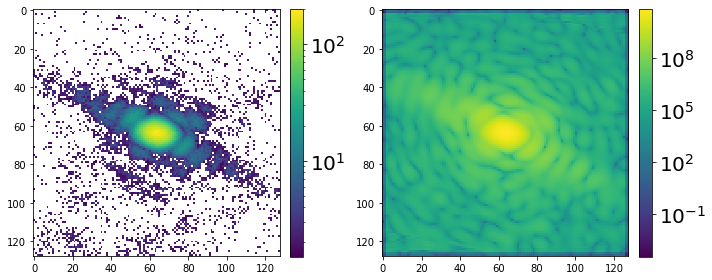

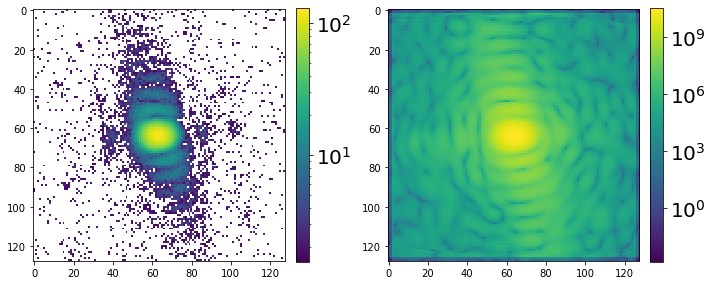

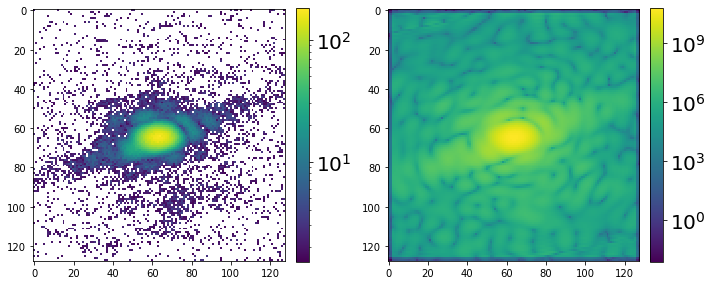

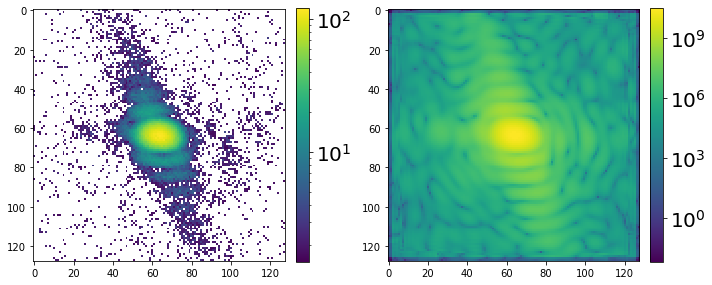

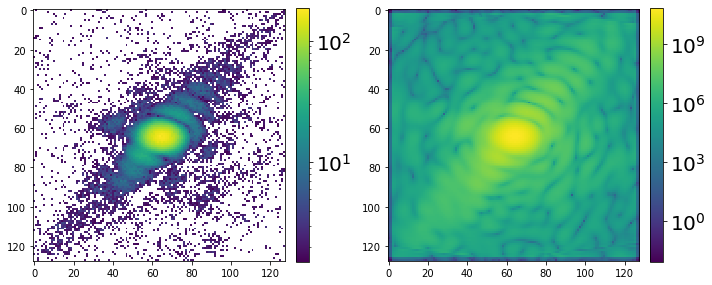

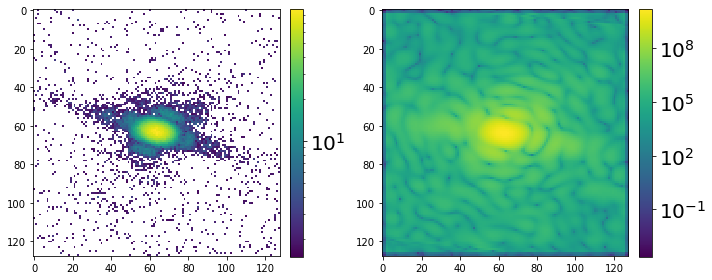

In [16]:
for n in range( len( solver.bragg_condition ) ):

    dat = fftshift_o( solver.bragg_condition[n][ 'data' ].detach().cpu().numpy() )
    obj = solver.getObjectInMount( n )
    fobj = fftshift_t( fftn_t( obj ) ).detach().cpu().numpy()
    intens = np.absolute( fobj )**2

    tp.TilePlot( 
        ( dat[:,:,64], intens[:,:,64] ), 
        ( 1, 2 ), 
        ( 10, 5 ), 
        log_norm=True
    )
    fig.canvas.draw()

In [17]:
data.close()

# Results dump
Accessible in HDF5 file named `Results_SiC.h5`. 

In [18]:
res = h5.File( resultfile, 'w' )

In [19]:
res.create_group( 'real_space' )
res[ 'real_space' ].create_dataset( 'electron_density', data=amp )
res[ 'real_space' ].create_dataset( 'lattice_deformation', data=u_recon )
res[ 'real_space' ].attrs[ 'scale' ] = list( 
    solver.x[-len(solver.bragg_condition):].detach().cpu().numpy() 
)

In [20]:
res.create_dataset( 'reconstruction_error', data=solver.error )

<HDF5 dataset "reconstruction_error": shape (91480,), type "<f8">

In [21]:
res.create_group( 'reciprocal_space' )
res[ 'reciprocal_space' ].attrs[ 'scan_names' ] = solver.scan_list
for n, scan in enumerate( [ st.replace( 'scans/', '' ) for st in solver.scan_list ] ):
    print( n, scan )
    obj = solver.getObjectInMount( n )
    fobj = fftshift_t( fftn_t( obj ) ).detach().cpu().numpy()
    res[ 'reciprocal_space' ].create_group( scan )
    res[ 'reciprocal_space/%s'%scan ].create_dataset( 'wave', data=fobj )
    res[ 'reciprocal_space/%s'%scan ].create_dataset( 'data', data=fftshift_o( solver.bragg_condition[n][ 'data' ].detach().cpu().numpy() ) )
    

0 dataset_0
1 dataset_1
2 dataset_2
3 dataset_3
4 dataset_4
5 dataset_5


In [22]:
res.close()